# 2η εργαστηριακή άσκηση

## Γκότση Πολυτίμη-Άννα (03117201) , Καπαρού Αλεξάνδρα (03117100)

## Ομάδα 33

# **Μέρος 1 : Θεωρητικό μέρος**

## **Η πυραμίδα στον Lucas-Kanade feature tracker**

**Πώς λειτουργεί:** 

Για κάθε επίπεδο της πυραμίδας υπολογίζεται το optical flow και ο μετασχηματισμός συγγένειας (affine transformation) μεταξύ δύο καρέ(frames). Αρχικά υπολογίζονται όλα τα επίπεδα της πυραμίας, με το επίπεδο 0 να είναι η αρχική εικόνα και κάθε επόμενο επίπεδο να προκύπτει συναρτήσει του προηγούμενου. Αρχικά υπολογίζεται η οπτική ροή και ο affine μετασχηματισμός στο πιο βαθύ επίπεδο της πυραμίδας(επίπεδο Lm). Στην συνέχεια, το αποτέλεσμα αυτό χρησιμοποιείται στο αμέσως υψηλότερο επίπεδο (Lm-1) με την μορφή της αρχικής πρόβλεψης της διάταξης των pixel και του μετασχηματισμού συγγένειας στο επίπεδο αυτό. Με βάση αυτή την αρχική υπόθεση υπολογίζονται η οπτική ροή και ο αφινικός μετασχηματισμός του επιπέδου μέσω της ελαχιστοποίησης μίας συνάρτησης κόστους η οποία σχετίζεται με την αλλαγή της θέσης ενός σημείου ενδιαφέροντος x μεταξύ των δύο εικόνων που εξετάζονται. Το αποτέλεσμα του υπολογισμού των δύο μεγεθών διαδίδεται στο επόμενο επίπεδο κοκ για όλα τα επίπεδα της πυραμίδας μέχρι το επίπεδο 0 που είναι η αρχική εικόνα.         


**Για ποιο λόγο χρησιμοποιείται:**

Σκοπός του αλγορίθμου Lucas Kanade είναι η ανίχνευση ενός αντικειμένου σε βίντεο με τρόπο ώστε να διατηρείται σταθερή σε αλλαγή της φωτεινότητας και των χαρακτηριστικών της εικόνας (π.χ. μέγεθος εικόνας) (robustness) και να έχει όσο το δυνατόν μεγαλύτερη τοπική ακρίβεια (accuracy).  

Καθώς η επίτευξη μεγαλύτερης ακρίβειας απαιτεί μικρότερο μέγεθος παραθύρου ολοκλήρωσης ενώ η παρακολούθηση μεγάλων κινήσεων απαιτεί μεγαλύτερο παράθυρο, χρησιμοποιούμε πυραμίδα στον αλγόριθμο Lucas-Kanade προκειμένου να πετύχουμε μία καλύτερη ισορροπία αυτών: Με την χρήση επιπέδων διαφορετικής ανάλυσης της εικόνας (διαφορετικό resolution) μπορούμε να έχουμε ένα σχετικά μικρό παράθυρο, εξασφαλίζοντας έτσι την ακρίβεια ανίχνευσης, ενώ παράλληλα, κινήσεις που είναι πολύ μεγάλες για να ανιχνευθούν επιτυχώς στην αρχική εικόνα με το συγκεκριμένο μέγεθος παραθύρου, γίνονται ανιχνεύσιμες σε επόμενα επίπεδα της πυραμίδας όπου το μέγεθος της εικόνας είναι μικρότερο. 


# **Μέρος 2 : Υλοποίηση αλγορίθμου**

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import numpy as np
from skimage import data
from skimage.feature import corner_harris, corner_subpix, corner_peaks,corner_shi_tomasi
from skimage.transform import warp, AffineTransform
from skimage.draw import ellipse

#### **Επειδή κάνουμε mount μέσω του google drive δεν θα πρέπει να γίνει run όλων των παρακάτω κελιών καθώς θα χρειαστεί authorization απο εμάς.**

In [ ]:
from google.colab import drive                                                          #Here we upload files saved in google drive
drive.mount('/gdrive')
import os
os.listdir('/gdrive/My Drive/Colab_Notebooks')

Mounted at /gdrive


['1st_team_exercise.ipynb',
 'output.mp4',
 'output2.mp4',
 'test.mp4',
 '2nd_exercise_team_33.ipynb',
 'Αντίγραφο του 2nd_exercise_team_33.ipynb',
 'Copy of final_ex_2.ipynb',
 'resized_video_50_sec.mp4',
 'screenshots',
 'copy2.ipynb',
 'final_ex_2.ipynb',
 'VIRAT_S_000201_04_000682_000822.mp4']

In [ ]:
video = '/gdrive/My Drive/Colab_Notebooks/VIRAT_S_000201_04_000682_000822.mp4'          #Here we read the original video

# **Ερώτημα 1:**

In [ ]:
                                                                                        # Create a VideoCapture object and read from input file
cap = cv2.VideoCapture(video)
height = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)
width = cap.get(cv2.CAP_PROP_FRAME_WIDTH)


height = int(height//2)                                                                 #Here we have resized our original video to height/2 and width/2
width=int(width//2)

                                                                                        #Define the codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'MP4V')
out = cv2.VideoWriter('output.mp4',fourcc, 20.0, (width,height))

while(cap.isOpened()):
    ret, frame = cap.read()
    if ret==True:
        frame = cv2.resize(frame, (width, height))
                                                                                        #Write the resized frame
        out.write(frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
        else:
            break

                                                                                        #Release everything at the end
cap.release()
out.release()

In [ ]:
from moviepy.video.io.ffmpeg_tools import ffmpeg_extract_subclip
ffmpeg_extract_subclip("output.mp4", 0, 50, targetname="resized_video_50_sec.mp4")      #Here we cut the resized video to 50 seconds


[MoviePy] Running:
>>> /usr/bin/ffmpeg -y -i output.mp4 -ss 0.00 -t 50.00 -vcodec copy -acodec copy resized_video_50_sec.mp4
... command successful.


In [ ]:
resized_video_50_sec = '/gdrive/My Drive/Colab_Notebooks/resized_video_50_sec.mp4'     #Here we load the short video

# **Ερώτημα 2:**

In [ ]:
def CornerDetector(img,maxCorners,qualityLevel,minDistance,blockSize,useHarrisDetector, plot=True):       #a function that detects corners
    params = dict( maxCorners = maxCorners,                                                               #parameters for corner detector
                       qualityLevel = qualityLevel,
                       minDistance = minDistance,
                       blockSize = blockSize,
                       useHarrisDetector = useHarrisDetector)
    
    image_ret=np.copy(img)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)                                                        #convert to grayscale
    corners = cv2.goodFeaturesToTrack(gray, mask = None, **params)                                        #detect corners
    for i in corners:
        x,y = i.ravel()
        cv2.circle(image_ret,(x,y),3,255,-1)                                                              #draw dots on conrners
    if plot:                                                                                              #plot image with detected conrners
        if useHarrisDetector:
            plt.title('Corner detection using Harris Detector')
        else:
            plt.title('Corner detection using Shi-Tomasi Detector')
        plt.imshow(image_ret, cmap='gray')  
    return image_ret,corners  

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                                              #We read our video and save it as cap
ret, image = cap.read()                                                                                   #ret is the response to see if it hase been loaded and image is the first frame
print(ret)

True


In [ ]:
def showVariableMaxCorners (image,qualityLevel,minDistance,blockSize,useHarrisDetector,plot,txt):        #a function to show plots with variable MaxCorners parameter
    fig, axs = plt.subplots(3, 2,figsize=(30, 30))
    fig.suptitle(txt, fontsize=40)
    interval = [1000,400,250,100,50,10]                                                                  #values for maxCorners parameter
    for i in range (len(interval)):    
        maxCorners=interval[i]
        frame1,corners1=CornerDetector(image, maxCorners ,qualityLevel,minDistance ,blockSize ,useHarrisDetector,plot)
        axs[i//2][i%2].imshow(frame1)
        axs[i//2][i%2].set_title('maxCorners={}'.format(maxCorners), fontsize=14)

In [ ]:
def showVariableQualityLevel (image,maxCorners,minDistance,blockSize,useHarrisDetector,plot,txt):        #a function to show plots with variable QualityLevel parameter
    fig, axs = plt.subplots(3, 2,figsize=(30, 30))
    fig.suptitle(txt, fontsize=40)
    interval = [0.7,0.5,0.25,0.1,0.02,0.005]                                                             #values for qualityLevel parameter
    for i in range (len(interval)):    
        qualityLevel=interval[i]
        frame1,corners1=CornerDetector(image, maxCorners ,qualityLevel,minDistance ,blockSize ,useHarrisDetector,plot)
        axs[i//2][i%2].imshow(frame1)
        axs[i//2][i%2].set_title('qualityLevel={}'.format(qualityLevel), fontsize=14)

In [ ]:
def showVariableMinDistance (image,maxCorners,qualityLevel,blockSize,useHarrisDetector,plot,txt):       #a function to show plots with variable MinDistance parameter
    fig, axs = plt.subplots(3, 2,figsize=(30, 30))
    fig.suptitle(txt, fontsize=40)
    interval = [50,15,7,2,0.5,0.001]                                                                    #values for minDistance parameter
    for i in range (len(interval)):    
        minDistance=interval[i]
        frame1,corners1=CornerDetector(image, maxCorners ,qualityLevel,minDistance ,blockSize ,useHarrisDetector,plot)
        axs[i//2][i%2].imshow(frame1)
        axs[i//2][i%2].set_title('minDistance={}'.format(minDistance), fontsize=14)

## **Για μεταβλητό maxCorners:**

Η παράμετρος maxcorners καθορίζει το μέγιστο πλήθoς γωνιών που θα επιστρέψει η συνάρτηση goodFeaturesToTrack. Σε περίπτωση που ο ανιχνευτής ανιχνεύει περισσότερες από όσες ορίζει η παράμετρος, τότε επιστρέφονται οι πιο ισχυρές γωνίες.

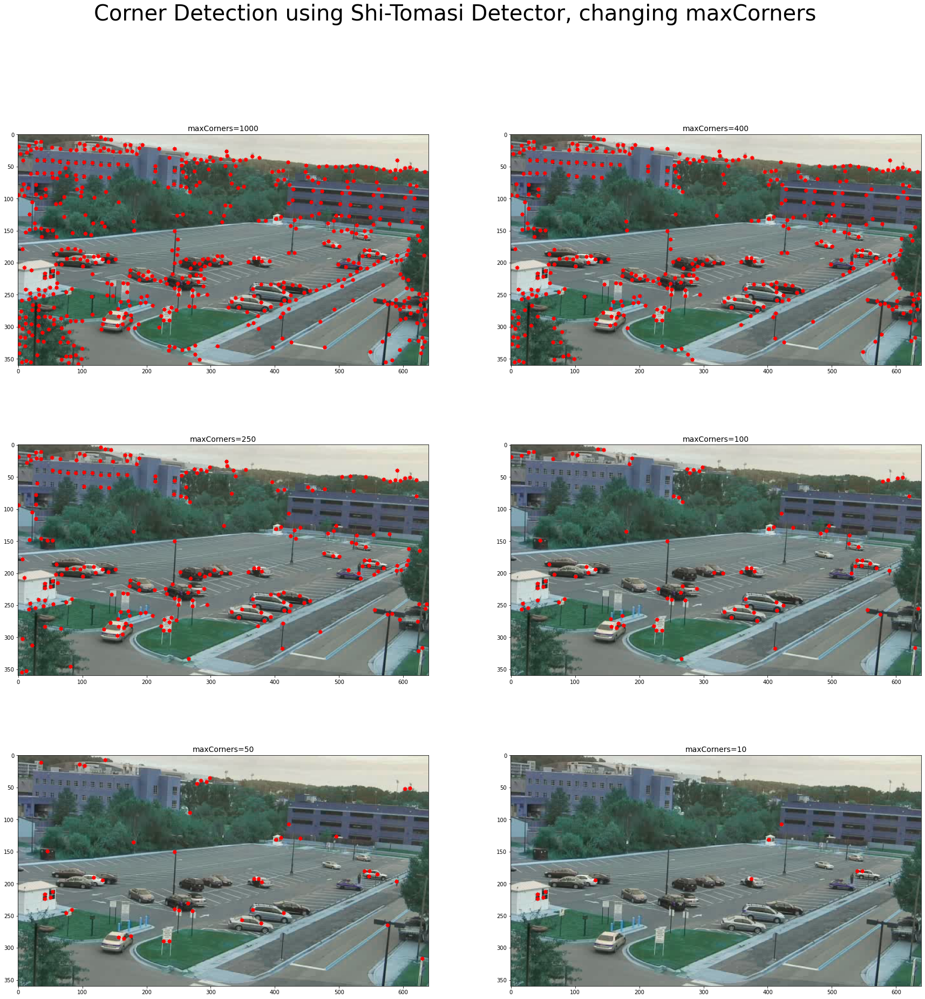

In [ ]:
qualityLevel=0.02
minDistance=7
blockSize = 7
useHarrisDetector=False
plot=False
txt="Corner Detection using Shi-Tomasi Detector, changing maxCorners"
showVariableMaxCorners(image,qualityLevel,minDistance ,blockSize ,useHarrisDetector,plot,txt)

Παρατηρούμε, όπως ήταν αναμενόμενο, ότι για μεγαλύτερες τιμές της παραμέτρου έχουμε περισσότερες γωνίες. Επιλέγουμε την βέλτιστη τιμή, εξετάζοντας κυρίως τις γωνίες που ανιχνεύονται στα αυτοκίνητα, αφού για την συγκεκριμένη εφαρμογή είναι τα αντικείμενα που μας αφορούν, για την ανίχνευση αργότερα της κίνησής τους. Παρατηρούμε ότι για τιμές maxCorners ίσες με 100, 50, 10 σε πολλά αυτοκίνητα δεν ανιχνεύεται καμία γωνία κάτι το οποίο δεν είναι επιθυμητό. Αντίθετα, για πολύ μεγάλες τιμές π.χ. 1000, παρατηρούμε μία πλεονάζουσα υπερανίχνευση στην εικόνα μας η οποία επίσης δεν είναι επιθυμητή (π.χ. ανιχνεύονται γωνίες στο φύλλωμα των δέντρων). Έτσι, καταλήγουμε πως βέλτιστη τιμή της παραμέτρου είναι περίπου στο 200-400. Επιλέγουμε τελικά την τιμή 250, για την οποία έχουμε πολύ καλή ανίχνευση γωνιών στις άκρες των αυτοκινήτων χωρίς ωστόσο να ανιχνεύονται περιττές και μη ισχυρές γωνίες στον περιβάλλοντα χώρο.\
Όσον αφορά τον ανιχνευτή Harris παίρνουμε τα παρακάτω αποτελέσματα:

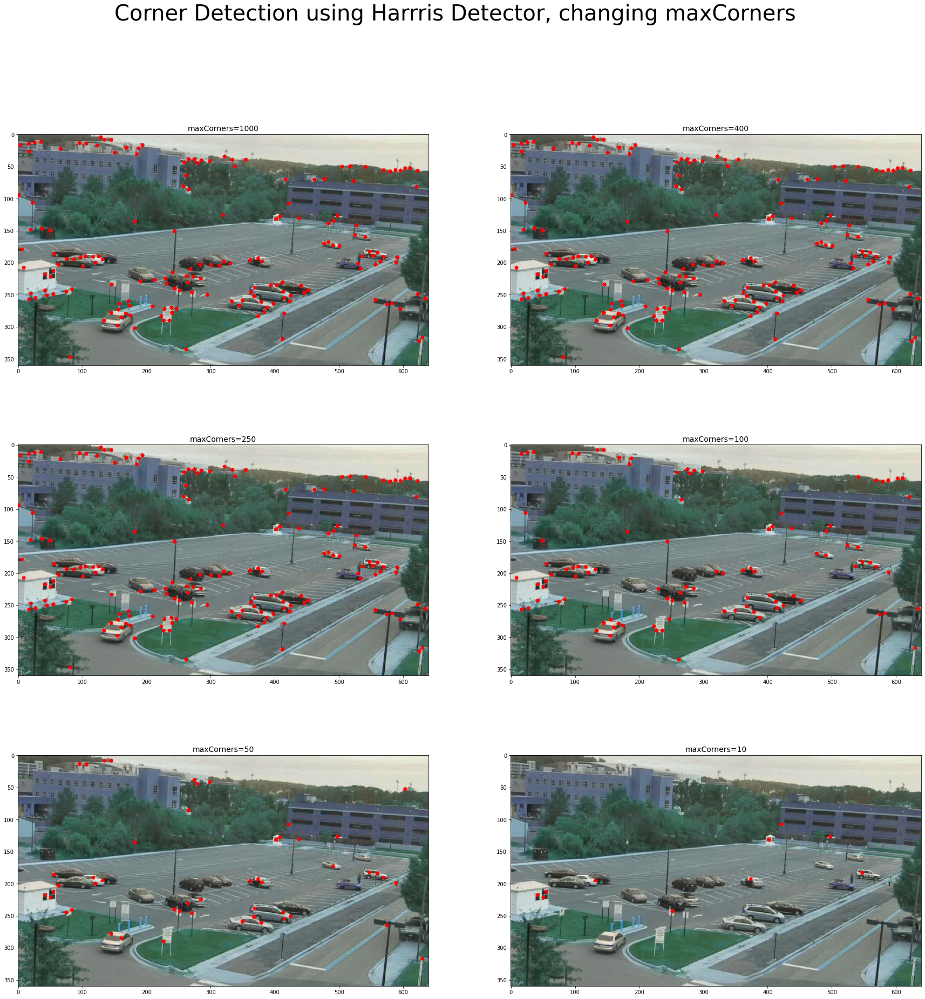

In [ ]:
qualityLevel=0.02
minDistance=7
blockSize = 7
useHarrisDetector=True
plot=False
txt="Corner Detection using Harrris Detector, changing maxCorners"
showVariableMaxCorners(image,qualityLevel,minDistance ,blockSize ,useHarrisDetector,plot,txt)

Συγκρίνοντας τα αποτελέσματα του ανιχνευτή Harris σε σχέση με τον Shi-Tomasi παρατηρούμε πως το πλήθος γωνιών που αυτός ανιχνεύει είναι μικρότερο από αυτό του Shi-Tomasi, για μεγαλύτερες τιμές του maxCorners και σχεδόν ίδιο για μικρότερες. Για μεγαλύτερες τιμές του maxCornes η διαφοροποίηση παρατηρείται κυρίως στο περιβάλλον, π.χ. ο Harris δεν ανιχνεύει τόσες γωνίες στα κτίρια, έχουμε όμως παρόμοιο αποτέλεσμα στα αυτοκίνητα. Επιπλέον όσον αφορά τον ανιχνευτή Harris, παρατηρούμε πως το αποτέλεσμα δεν αλλάζει για τιμές maxCorners 200, 400, 1000, το οποίο σημαίνει πως ο ανιχνευτής έχει ανιχνεύσει το μέγιστο πλήθος γωνιών που του ήταν δυνατό. Εφόσον λοιπόν τα αποτελέσματα είναι αντίστοιχα, επιλέγουμε ως βέλτιστη τιμή την τιμή 250, για λόγους ομοιογένειας με τον Shi-Tomasi ανιχνευτή.




## **Για μεταβλητό qualityLevel:**

Η παράμετρος qualityLevel καθορίζει την ελάχιστη αποδεκτή ποιότητα μίας γωνίας που επιστρέφεται. Το μέτρο της ποιότητας μιας γωνίας καθορίζεται ως η ελάχιστη από τις ιδιοτιμές του πίνακα covariance παραγώγων ή η τιμή 
dst(x,y)=det(M(x,y))-k*(tr(M(x,y))^2
στην ανίχνευση Harris.

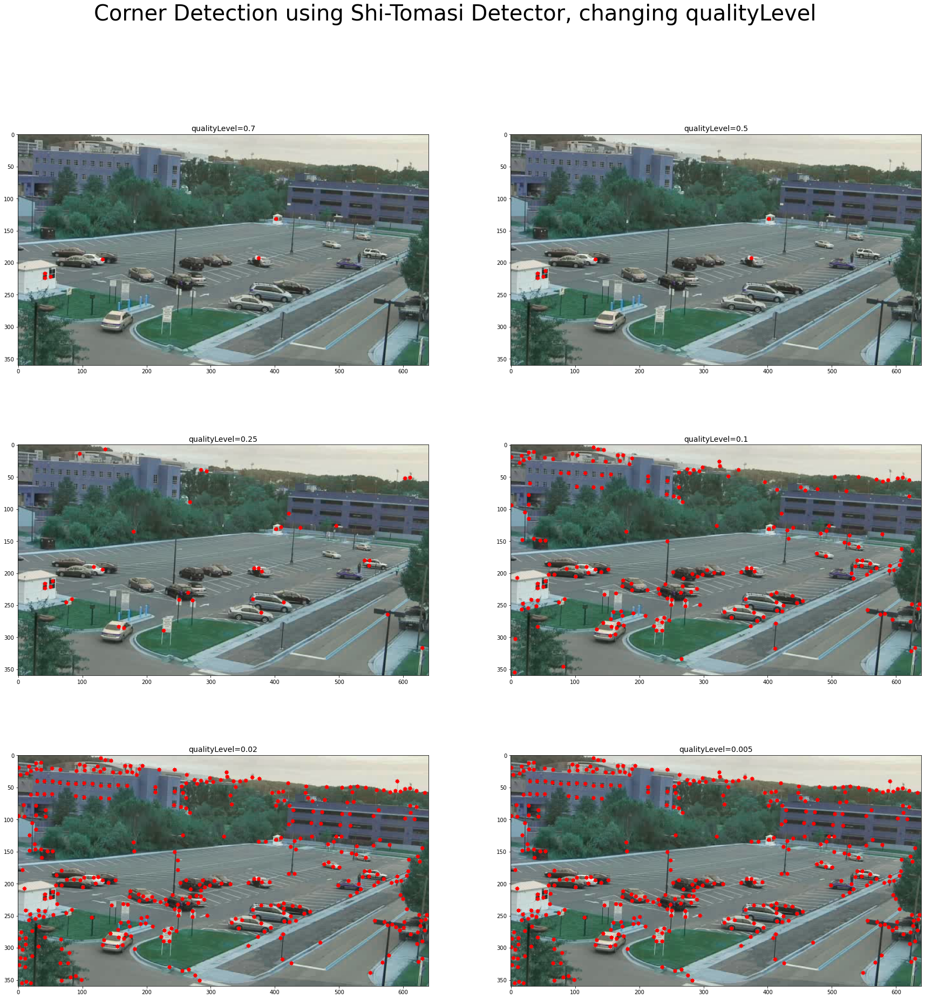

In [ ]:
maxCorners=400
minDistance=7
blockSize = 7
useHarrisDetector=False
plot=False
txt="Corner Detection using Shi-Tomasi Detector, changing qualityLevel"
showVariableQualityLevel (image,maxCorners,minDistance,blockSize,useHarrisDetector,plot,txt)

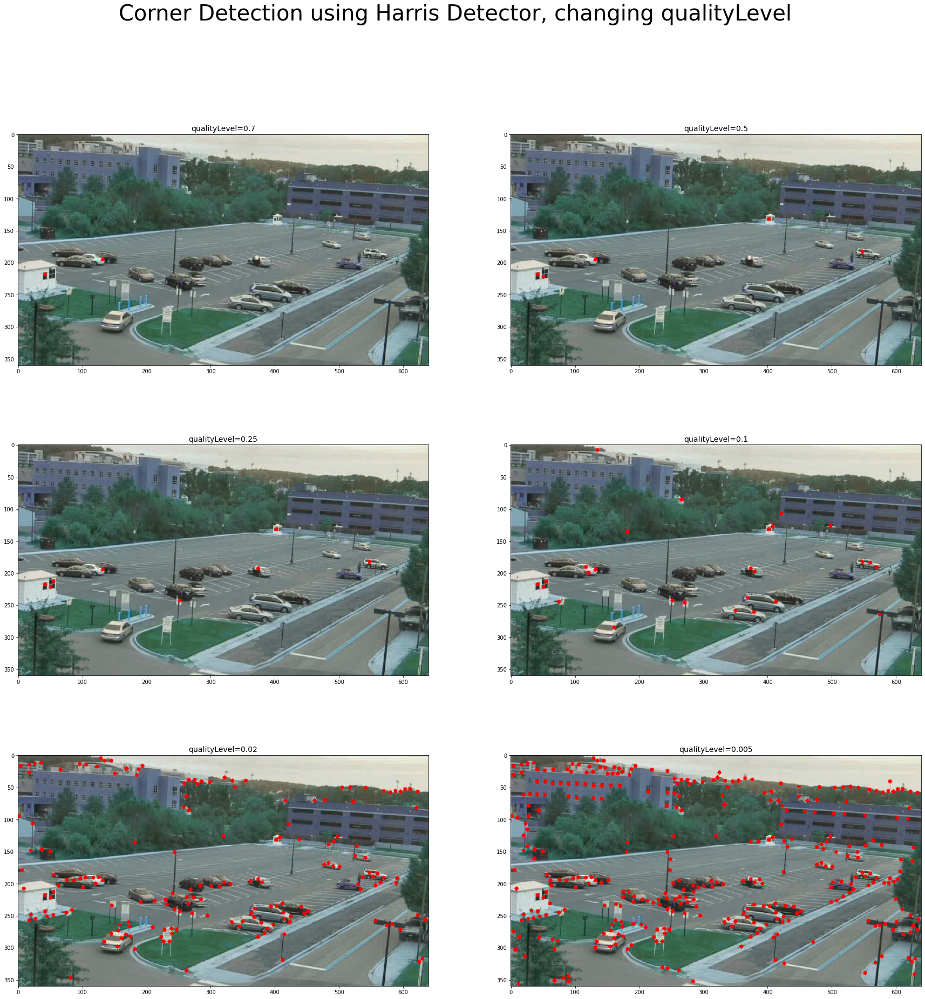

In [ ]:
maxCorners=400
minDistance=7
blockSize = 7
useHarrisDetector=True
plot=False
txt="Corner Detection using Harris Detector, changing qualityLevel"
showVariableQualityLevel (image,maxCorners,minDistance,blockSize,useHarrisDetector,plot,txt)

Όπως ήταν αναμενόμενο από την σημασία της παραμέτρου, όσο πιο μικρή είναι η τιμή αυτής τόσο περισσότερες είναι οι γωνίες που ανιχνεύονται, αφού τόσο χαμηλότερη χρειάζεται να είναι η ποιότητα μίας γωνίας. Παρατηρούμε ότι για qualityLevel σε τιμές περίπου 0.1 και πάνω, μεγάλο μέρος των γωνιών απορρίπτεται, κάτι το οποίο δεν είναι επιθυμητό αφού απορρίπτονται και γωνίες πάνω στα αυτοκίνητα. Έτσι, επιλέγουμε ως βέλτιστη τιμή το 0.02, τιμή η οποία οδηγεί σε όσο το δυνατόν μικρότερη υπερανίχνευση στο περιβάλλον, αλλά παράλληλα δεν απορρίπτει "χρήσιμες" ,για την ανίχνευση κίνησης, γωνίες των αυτοκινήτων καθώς είναι ισχυρότερες αυτών του περιβάλλοντα χώρου και επομένως υπερισχύουν των υπολοίπων στο τελικό αποτέλεσμα.

## **Για μεταβλητό minDistance:**

Η παράμετρος minDistance καθορίζει την ελάχιστη επιτρεπτή απόσταση μεταξή δύο γωνιών που επιστρέφονται από την goodFeaturesToTrack.

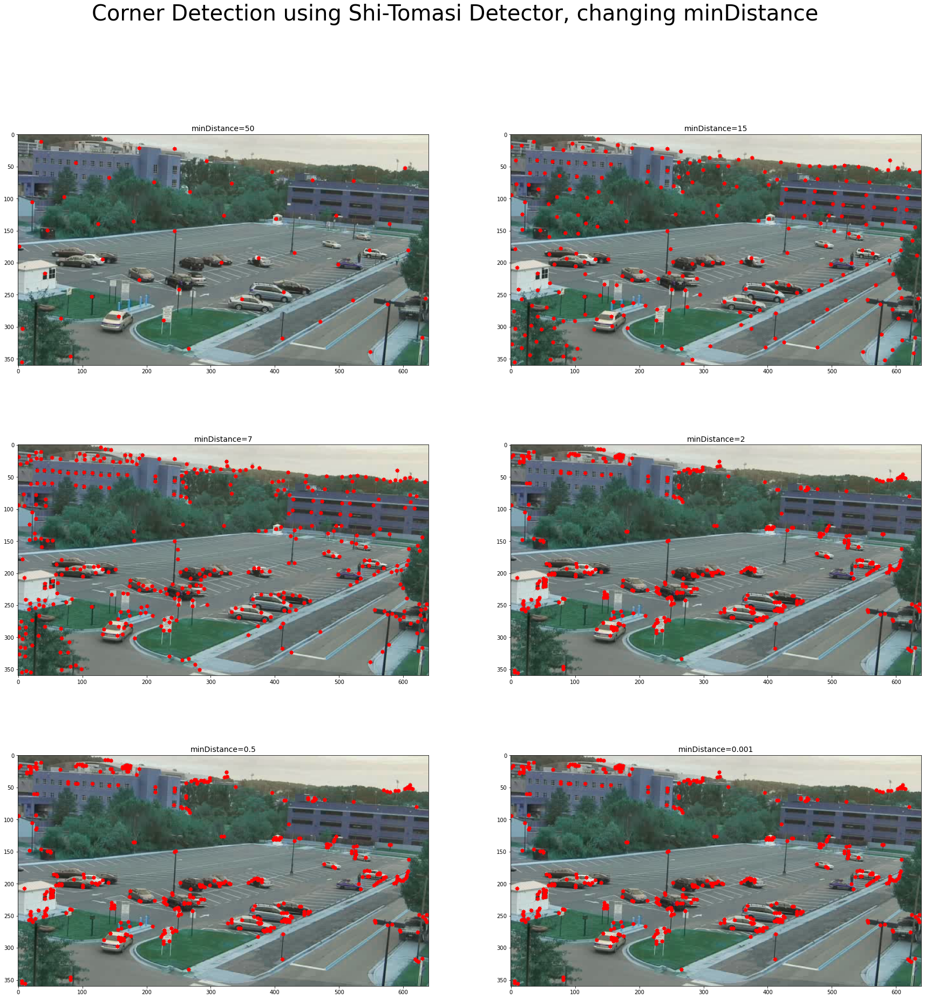

In [ ]:
maxCorners=400
qualityLevel=0.02
blockSize = 7
useHarrisDetector=False
plot=False
txt="Corner Detection using Shi-Tomasi Detector, changing minDistance"
showVariableMinDistance (image,maxCorners,qualityLevel,blockSize,useHarrisDetector,plot,txt)

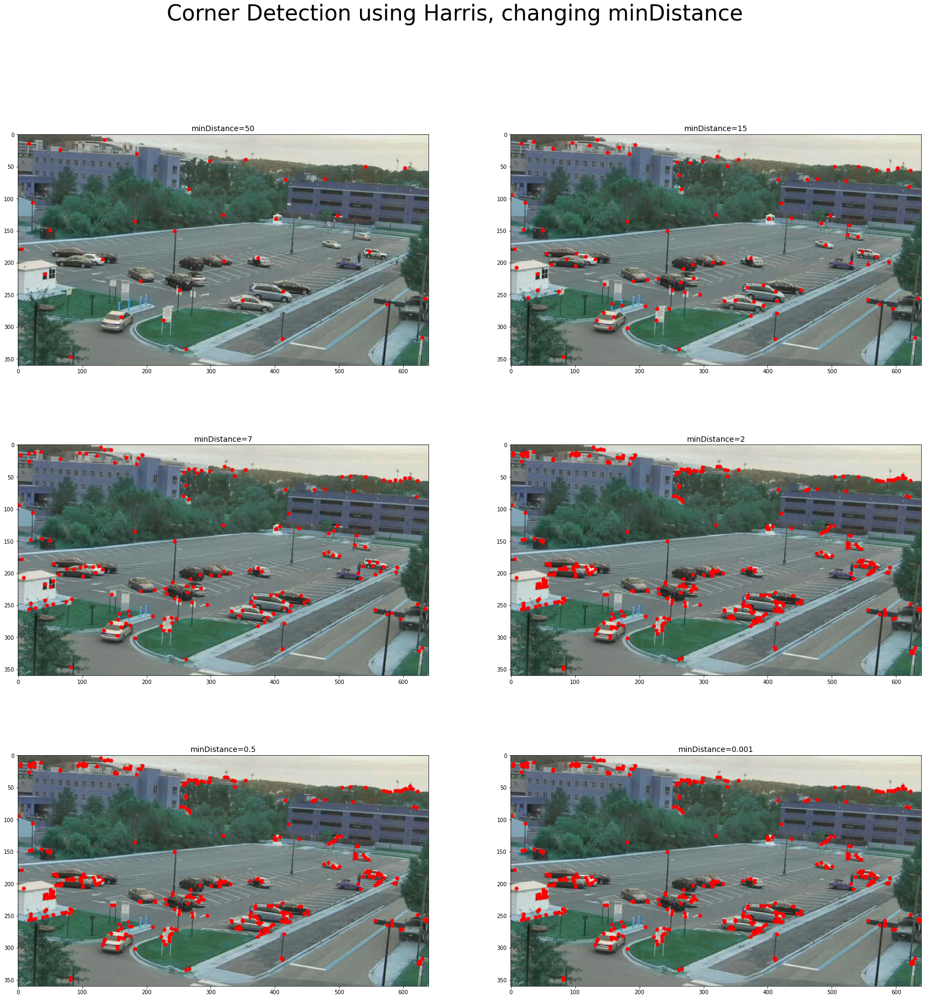

In [ ]:
maxCorners=400
qualityLevel=0.02
blockSize = 7
useHarrisDetector=True
plot=False
txt="Corner Detection using Harris, changing minDistance"
showVariableMinDistance (image,maxCorners,qualityLevel,blockSize,useHarrisDetector,plot,txt)

Παρατηρούμε ότι για πολύ μεγάλες τιμές του minDistance οι γωνίες που επιστρέφονται είναι πολύ λίγες, το οποίο είναι αναμενόμενο καθώς απαιτούμε να απέχουν πμεγάλη απόσταση μεταξύ τους. Αντίθετα, για πολύ μικρές τιμές του minDistance δεν εξασφαλίζουμε αρκετά μεγάλες αποστάσεις μεταξύ των γωνιών με αποτέλεσμα να επιστρέφονται πολλαπλά σημεία που αντιστοιχούν στην ίδια περίπου γωνία ενός αντικειμένου και έτσι να οδηγούμστε σε υπερανίχνευση. Καταλήγουμε τελικά πως μία τιμή περίπου ίση με 7 επιτυγχάνει την βέλτιση ισορροπία στην ύπαρξη απόσταση μεταξύ γωνιών, χωρίς να χάνουμε παράλληλα γωνίες που είναι σημαντικές.

Όσον αφορά την διαφοροποίηση των δύο ανιχνευτών Harris και Shi-Tomasi, μπορούμε από το σύνολο των παραπάνω πειραμάτων να παρατηρήσουμε οι δύο ανιχνευτές έχουν αρκετά παρόμοια συμπεριφορά, με τον Shi-Tomasi να ανιχνεύει πολλές φορές ισχυρότερες γωνίες στο περιβάλλον (δέντρα , κτίρια) σε σχέση με τον Harris. Όσον αφορά όμως την ανίχνευση γωνιών σε αυτοκίνητα, τα οποία αφορά η παρούσα εφαρμογή, τα αποτελέσματα των δύο ανιχνευτών είναι αρκετά παρόμοια για ίδιες παραμέτρους maxCorners, minLevel, minDistance.

Έτσι, καταλήγουμε στις παρακάτω **βέλτιστες** παραμέτρους:

In [ ]:
#chosen parameters for best results
maxCorners=250
qualityLevel=0.02
minDistance = 7
blockSize = 7

# **Ερώτημα 3:**

In [ ]:
from google.colab.patches import cv2_imshow
import cv2
import math

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #Read the video again

ret, frame = cap.read()                                                               #Read first frame
frames=[frame]                                                                        #Save first frame in array    
while(frame is not None):                                                             #Read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

In [ ]:
def Lukas_Kanade_function(frame,cap,winSize,maxLevel,criteria):                       #Α function to compute Lukas Kanade algorithm
    frame=frames[0]                                                                   #Parameters for Shi Tomasi corner detection
    feature_params = dict( maxCorners = 250,
                          qualityLevel = 0.02,
                          minDistance = 7,
                          blockSize = 7)

                                                                                      #Parameters for lucas kanade optical flow
    lk_params = dict( winSize = winSize,
                     maxLevel = maxLevel,
                     criteria = criteria)
    screenshot_time=0                                                                 #Screenshot time is set to 30
                                                                                      #Create some random colors
    color = np.random.randint(0,255,(400,3))

                                                                                      #Take first frame and find corners in it
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    p0 = cv2.goodFeaturesToTrack(gray, mask = None, **feature_params)

                                                                                      #Create a mask image for drawing purposes
    mask = np.zeros_like(frame) 
    for tmp in range (1, len(frames)-1):                                                                         
        frame=frames[tmp]                                                             #Read next frame
        tmp=tmp+1
        frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
                                                                                      #Calculate optical flow
        p1, st, err = cv2.calcOpticalFlowPyrLK(gray, frame_gray, p0, None, **lk_params)
        
                                                                                      #Select good points
        if p1 is not None:
            good_new = p1[st==1]
            good_old = p0[st==1]
        
                                                                                      #Draw the tracks
        for i,(new,old) in enumerate(zip(good_new, good_old)):
            a,b = new.ravel()
            c,d = old.ravel()
            mask = cv2.line(mask, (int(a),int(b)),(int(c),int(d)), color[i].tolist(), 2)
            frame = cv2.circle(frame,(int(a),int(b)),5,color[i].tolist(),-1)
        img = cv2.add(frame,mask)
        if (screenshot_time==20):                                                     #Time for screenshot
           cv2_imshow(img)
           screenshot_time=0
        else:
           screenshot_time=screenshot_time+1

        k = cv2.waitKey(30) & 0xff
        if k == 27:
          cap.release()
          break
        gray = frame_gray.copy()
        p0 = good_new.reshape(-1,1,2)
        

In [ ]:
winSize= (15,15)
maxLevel= 2
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function(frame,cap,winSize,maxLevel,criteria)                         

Παρακάτω υλοποιήσαμε μία συνάρτηση που τρέχει τον παραπάνω αλγόριθμο αλλά τυπώνει μόνο το τελευταίο frame ώστε να γίνεται πιο εύκολα η σύγκριση μεταξύ των διαφορετικών παραμέτρων:

In [ ]:
def Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,useHarrisDetector):  #Α function to compute Lukas Kanade algorithm and show only the last frame

    
    frame=frames[0]                                                                   #Parameters for Shi Tomasi corner detection
    feature_params = dict( maxCorners = 250,
                          qualityLevel = 0.02,
                          minDistance = 7,
                          blockSize = 7,
                          useHarrisDetector = useHarrisDetector)

                                                                                      #Parameters for lucas kanade optical flow
    lk_params = dict( winSize = winSize,
                     maxLevel = maxLevel,
                     criteria = criteria,
                     minEigThreshold=minEigThreshold)
    screenshot_time=0                                                                 #Screenshot time is set to 30
                                                                                      #Create some random colors
    color = np.random.randint(0,255,(400,3))

                                                                                      #Take first frame and find corners in it
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    p0 = cv2.goodFeaturesToTrack(gray, mask = None, **feature_params)

                                                                                      #Create a mask image for drawing purposes
    mask = np.zeros_like(frame) 
    for tmp in range (1, len(frames)-1):                                                                         
        frame=frames[tmp]                                                             #read next frame
        tmp=tmp+1
        frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
                                                                                      #Calculate optical flow
        p1, st, err = cv2.calcOpticalFlowPyrLK(gray, frame_gray, p0, None, **lk_params)
        
                                                                                      #Select good points
        if p1 is not None:
            good_new = p1[st==1]
            good_old = p0[st==1]
        
                                                                                      #Draw the tracks
        for i,(new,old) in enumerate(zip(good_new, good_old)):
            a,b = new.ravel()
            c,d = old.ravel()
            mask = cv2.line(mask, (int(a),int(b)),(int(c),int(d)), color[i].tolist(), 2)
            frame = cv2.circle(frame,(int(a),int(b)),5,color[i].tolist(),-1)
        img = cv2.add(frame,mask)
        if (tmp==(len(frames)-1)):
           cv2_imshow(img)
           

        k = cv2.waitKey(30) & 0xff
        if k == 27:
          cap.release()
          break
        gray = frame_gray.copy()
        p0 = good_new.reshape(-1,1,2)
        

## **Για μεταβολή του window size:**

* Για winSize = (5,5)

Shi Tomasi Detector


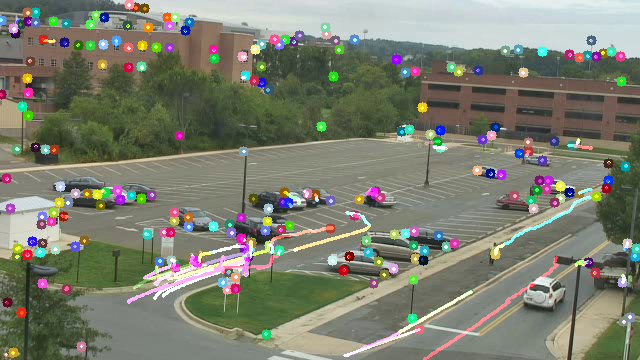

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

txt = "Shi Tomasi Detector"
print(txt.title()) 
winSize= (5,5)
maxLevel= 2
minEigThreshold=1e-4
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,False)   

Harris Detector


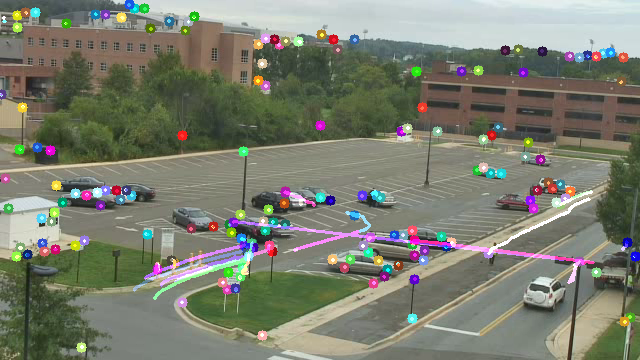

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

txt = "Harris Detector"
print(txt.title()) 
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,True)  

* Για winSize = (15,15)



Shi Tomasi Detector


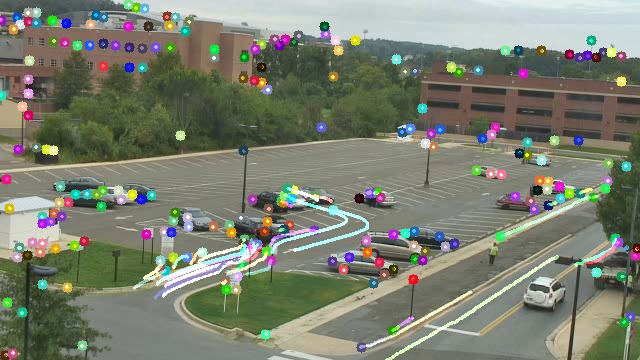

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

txt = "Shi Tomasi Detector"
print(txt.title()) 
winSize= (15,15)
maxLevel= 2
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,False)   

Harris Detector


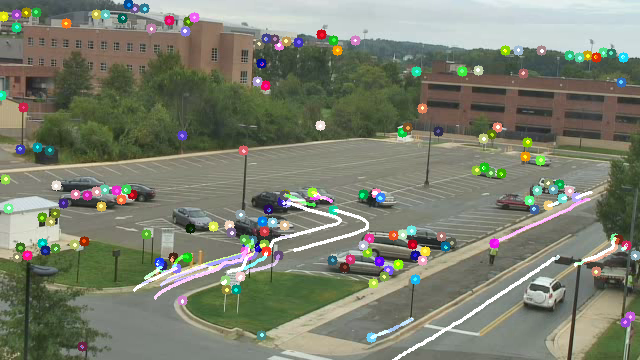

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

txt = "Harris Detector"
print(txt.title()) 
winSize= (15,15)
maxLevel= 2
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,True)   

* Για winSize = (20,20)

Shi Tomasi Detector


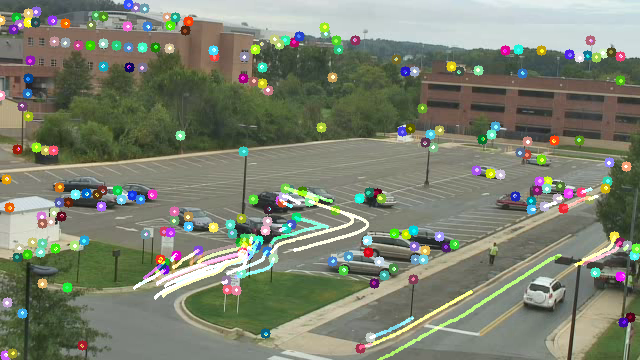

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

txt = "Shi Tomasi Detector"
print(txt.title()) 
winSize= (20,20)
maxLevel= 2
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,False) 

Harris Detector


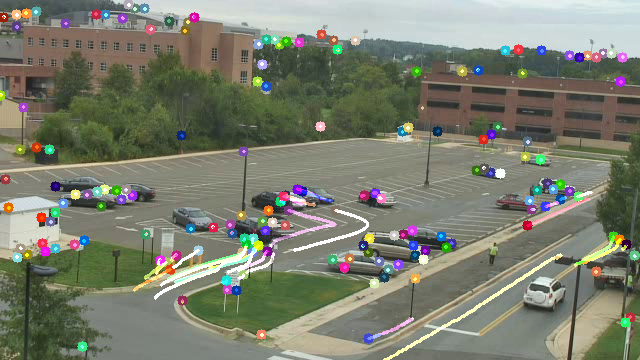

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

txt = "Harris Detector"
print(txt.title()) 
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,True) 

* Για winsize = (45,45)

Shi Tomasi Detector


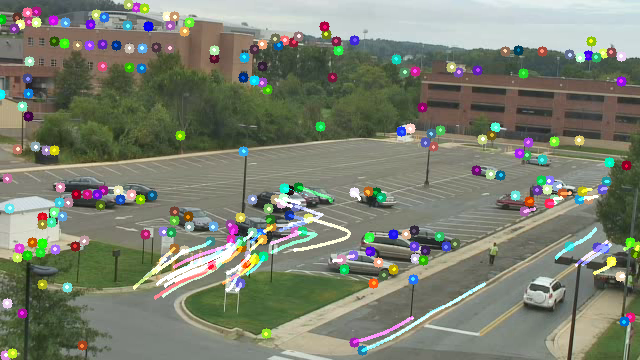

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

txt = "Shi Tomasi Detector"
print(txt.title()) 
winSize= (45,45)
maxLevel= 2
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,False)   

Harris Detector


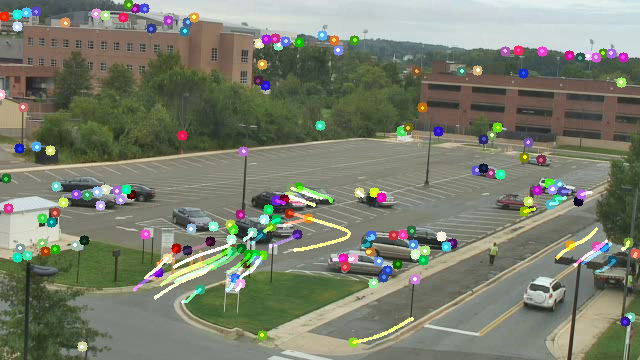

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

txt = "Harris Detector"
print(txt.title()) 
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,True)  

## **Για μεταβολή του max level:**

* Για maxLevel = 0

Shi Tomasi Detector


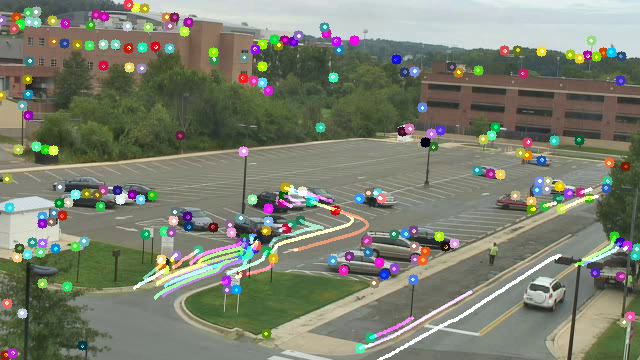

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 0
txt = "Shi Tomasi Detector"
print(txt.title()) 
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,False)   

Harris Detector


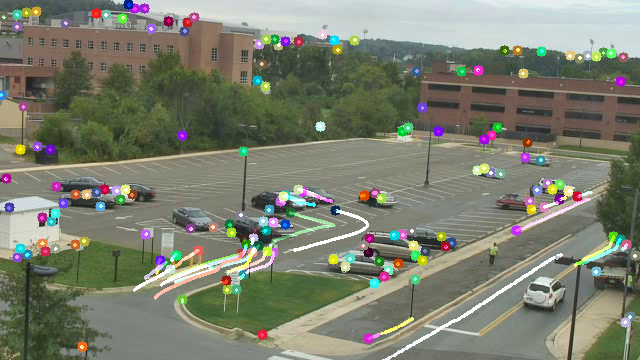

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

txt = "Harris Detector"
print(txt.title()) 
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,True)  



*   Για maxLevel=3:





Shi Tomasi Detector


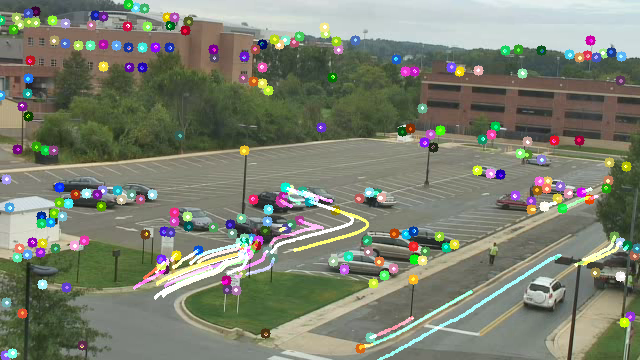

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 3
txt = "Shi Tomasi Detector"
print(txt.title()) 
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,False) 

Harris


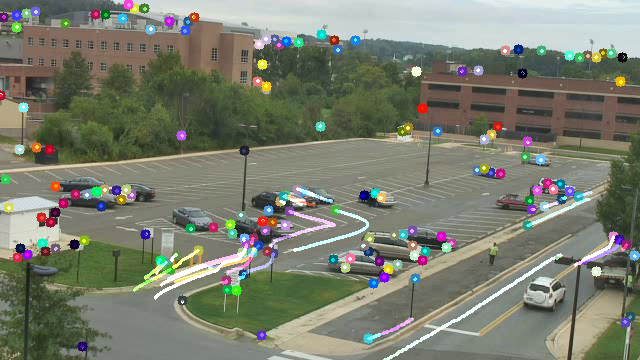

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 3
txt = "Harris"
print(txt.title()) 
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,True) 

* Για maxLevel = 4

Shi Tomasi Detector


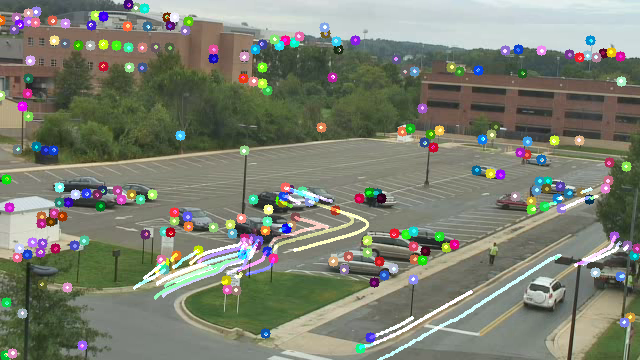

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 4
txt = "Shi Tomasi Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,False)   

Harris Detector


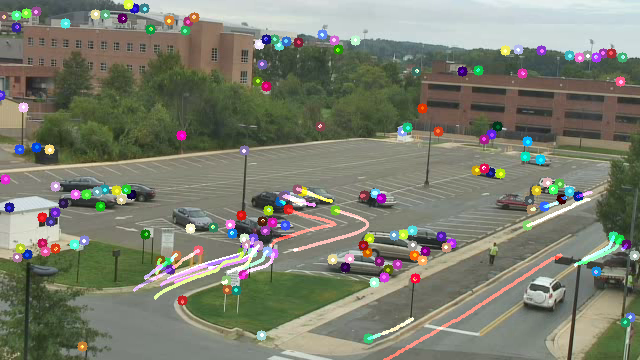

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 4
txt = "Harris Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,True)  

* Για maxLevel = 22

Shi Tomasi Detector


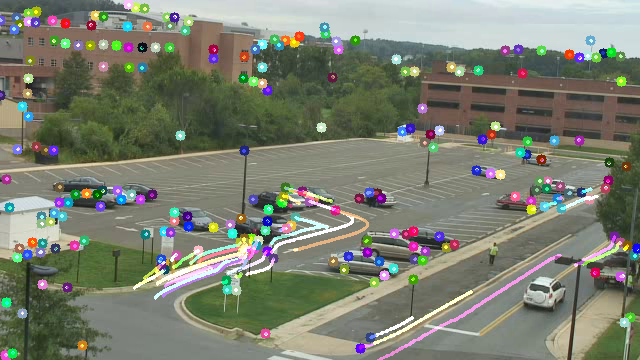

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 22
txt = "Shi Tomasi Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,False)   

Harris Detector


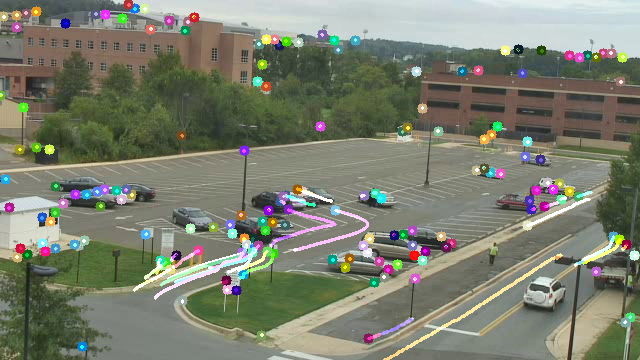

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 22
txt = "Harris Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,True) 

* Για maxLevel = 50

Shi Tomasi Detector


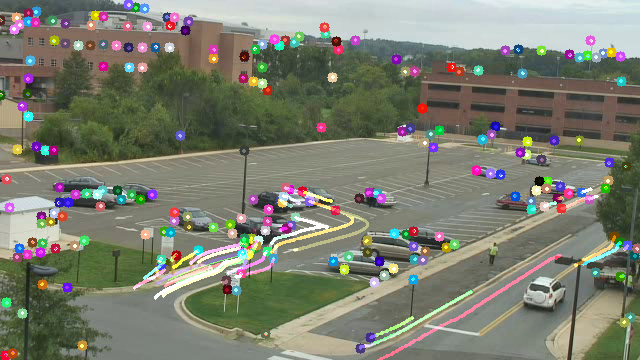

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 50
txt = "Shi Tomasi Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,False)   

Harris Detector


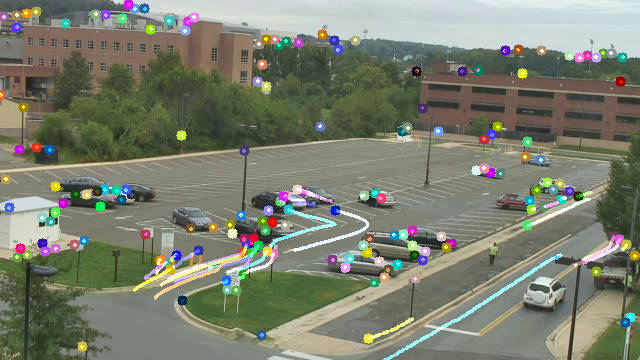

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 50
txt = "Harris Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,True)   

## **Μεταβολή της παραμέτρου criteria**

* Για criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 0, 0.03)

Shi Tomasi Detector


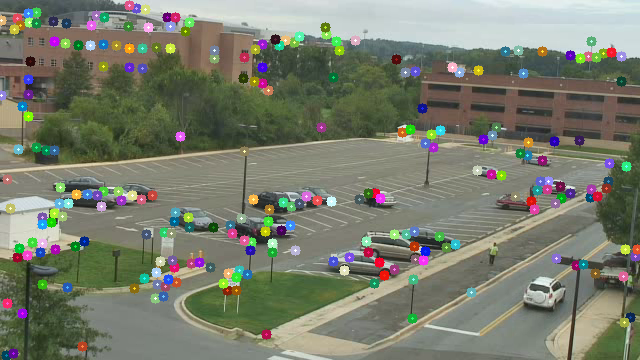

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 4
txt = "Shi Tomasi Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 0, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,False)   

Harris Detector


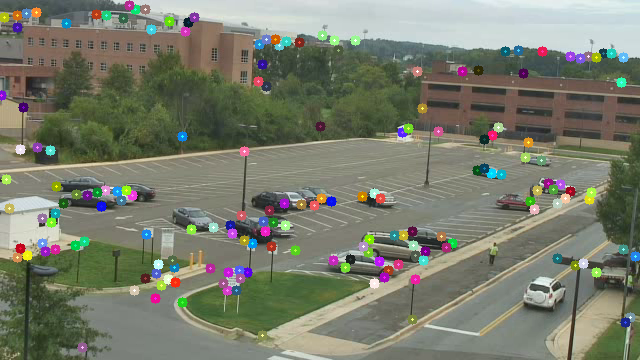

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 4
txt = "Harris Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 0, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,True)  

* Για criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)

Shi Tomasi Detector


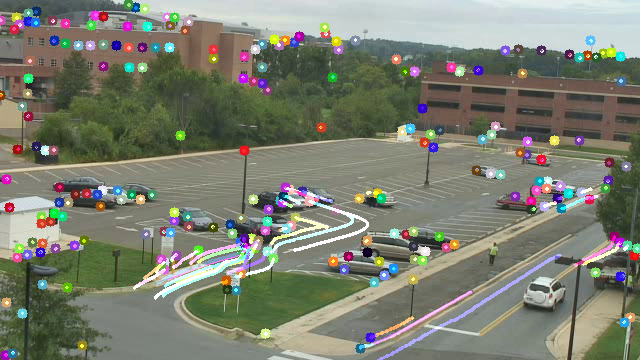

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 4
txt = "Shi Tomasi Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,False)   

Harris Detector


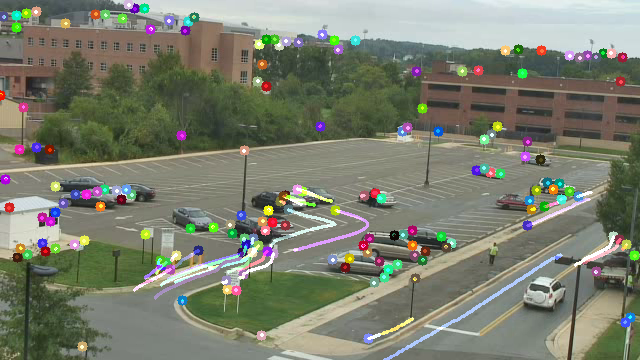

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 4
txt = "Harris Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,True)  

* Για criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 40, 0.03)



Shi Tomasi Detector


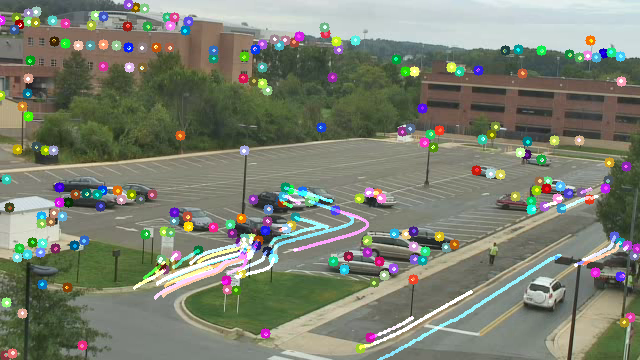

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 4
txt = "Shi Tomasi Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 40, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,False)   

Harris Detector


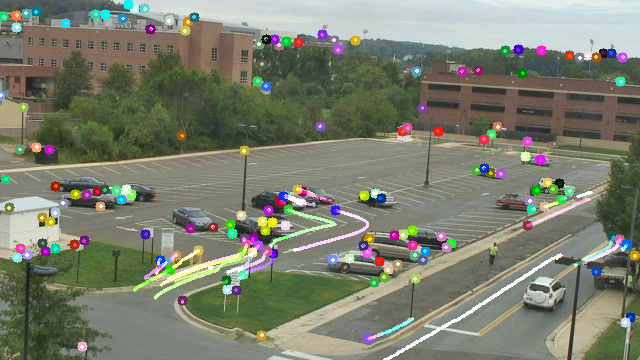

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 4
minEigThreshold=1e-4
txt = "Harris Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 40, 0.03)
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,True)  

## **Μεταβολή της παραμέτρου minEigThreshold**

* Για minEigThreshold = 1e-4

Shi-Tomasi Detector


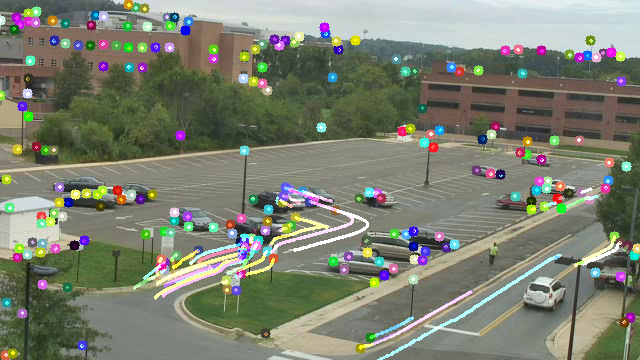

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 4
txt = "Shi-Tomasi Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
minEigThreshold=1e-4
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,False)  

Harris Detector


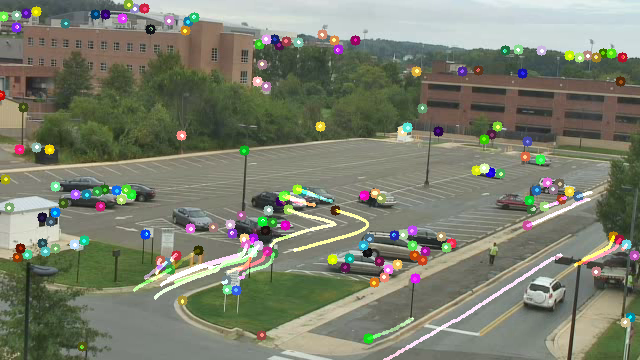

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 4
txt = "Harris Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
minEigThreshold=1e-4
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,True)  

* Για minEigThreshold = 1e-1

Shi-Tomasi Detector


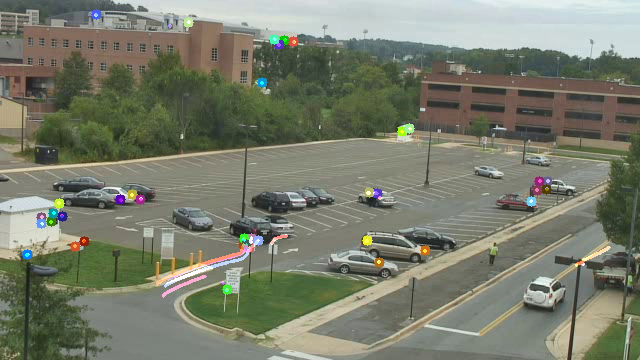

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 4
txt = "Shi-Tomasi Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
minEigThreshold=1e-1
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,False)  

Harris Detector


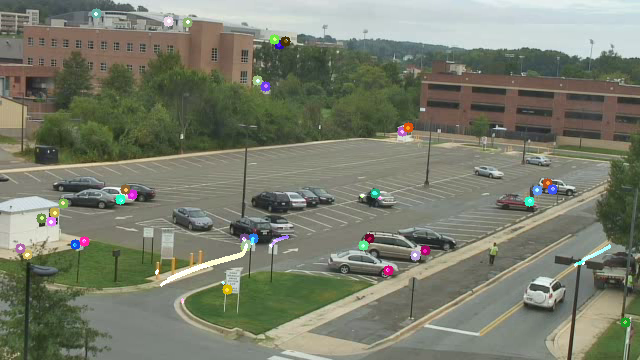

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

winSize= (20,20)
maxLevel= 4
txt = "Harris Detector"
print(txt.title())
criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03)
minEigThreshold=1e-1
Lukas_Kanade_function_screenshot(frame,cap,winSize,maxLevel,criteria,minEigThreshold,True)  

## **Συμπεράσματα:**
**Μεταβολή του window size:**\
Η παράμετρος window size χαρακτηρίζει το μέγεθος του παραθύρου αναζήτησης σε κάθε επίπεδο της πυραμίδας. Μικρές τιμές του παραθύρου (πχ 5,5) είναι πιο ευαίσθητες στον θόρυβο και μπορεί να μην ανιχνεύσουν πλήρως μεγάλες κινήσες (πχ διακόπτονται οι γραμμές κίνησης του αυτοκινήτου πάνω αριστερά). Για μεγάλες τιμές του window size (πχ 45,45) βλέπουμε ότι έχουμε πιο ομαλή ανίχνευση της κίνησης και εμφάνιση περισσότερων γραμμών flow. παρατηρώντας ωστόσο ότι και πάλι κάποιες γραμμές διακόπτονται καθώς εξομαλύνονται οι λεπτομέρειες που περιέχονται σε κάθε frame.\
**Η βέλτιστη επιλογή window size είναι (20,20)**

**Μεταβολή του max level:**\
Η παράμετρος max level χαρακτηρίζει το πλήθος των επιπέδων της πυραμίδας που χρησιμοποιείται. Αν maxLevel=0 τότε δεν χρησιμοποιείται πυραμίδα ενώ αν παραδείγματος χάρη maxlevel=10 τότε έχουμε 11 επίπεδα. Η χρήση πυραμίδας επιτρέπει την εύρεση optical flow σε διάφορα resolutions της εικόνας, επιτρέποντας έτσι την ανίχνευση μεγαλύτερων κινήσεων για συγκεκριμένο μέγεθος παραθύρου. Σύμφωνα με το paper "Pyramidal Implementation of the Affine Lucas Kanade Feature Tracker Description of the algorithm" δεν έχει νόημα να έχουμε πάνω από 2-4 επίπεδα στις περισσότερες περιπτώσεις. Πράγματι, αυτό επιβεβαιώνεται και από τα παραπάνω πειράματά μας όπου δοκιμάζοντας maxLevel 22, 50 δεν παρατηρούμε βελτωμένο αποτέλεσμα σε σχέση με την περίπτωση τιμής maxLevel ίσης με 3 ή 4. \
**Έτσι επιλέγουμε max level ίσο με 4** 

**Μεταβολή της παραμέτρου criteria:**\
H παράμετρος αυτή χαρακτηρίζει τα κριτήρια τερματισμού του επαναληπτικού αλγορίθμου που χρησιμοποιείται.Πιο συγκεκριμένα, η παράμετρος max number καθορίζει τον μέγιστο αριθμό επαναλήψεων ενώ το epsilon την μέγιστη μετακίνηση του παραθύρου αναζήτησης. Παρατηρούμε ότι για τιμές κοντά στο 0 για το max number, επειδή δεν γίνονται πολλές επαναλήψεις δεν ανιχνεύεται σωστά η οπτική κίνηση ενώ για μεγαλύτερο από ένα threshold δεν παρατηρούμε μεταβολή στην ποιότητα ανίχνευσης του optical flow. Περισσότερες επαναλήψεις οδηγούν σε πιο εξαντλητική αναζήτηση σημείων ενώ μικρότερο epsilon οδηγεί σε μικρότερο χρόνο εύρεσης τους. Βλέπουμε λοιπόν ότι υπάρχει ένα tradeoff μεταξύ accuracy και speed. Θα κρατήσουμε τις τυπικές παραμέτρους που χρησιμοποιούνται για την ανίχνευση του optical flow,δηλαδή:\
**Η βέλτιστη επιλογή της παραμέτρου criteria είναι (10,0.03)**

**Μεταβολή της παραμέτρου minEigThreshold:**\
Η παράμετρος minEigThreshold καθορίζει την ελάχιστη eigen value του 2 επί 2 πίνακα των εξισώσεων οπτικής ροής. Τιμές μικρότερες από αυτή την παράμετρο απορρίπτονται επομένως χρησιμοποιείται για να αφαιρέσει αδιάφορα σημεία και να αυξήσει την ταχύτητα μιας και η οπτική ροή των αδιάφορων σημείων δεν υπολογίζεται.\
**Η βέλτιστη επιλογή της παραμέτρου minEigThreshold είναι 1e-4 που είναι και η default**

**Σύγκριση των ανιχνευτών Shi Tomasi και Harris**\
Με βάση τα παραπάνω αποτελέσματα, συμπεραίνουμε πως και οι δύο παράγουν παρόμοια αποτελέσματα, ωστόσο ο Shi Tomasi πετυχαίνει ελαφρώς καλύτερη ανίχνευση των γωνιών σε σύγκριση με τον Harris και επομένως η οπτική ροή εντοπίζεται καλύτερα.\
**Επομένως σαν βέλτιστη επιλογή ανιχνευτή θεωρούμε τον Shi Tomasi**

# **Ερώτημα 4:**

Ορίζουμε αρχικά τις παραμέτρους για την ανίχνευση κίνησης καθώς και για την ανίχνευση γωνιών. (Επιλέγουμε ως παραμέτρους αυτές που καθορίσαμε ως βέλτιστες στα παραπάνω ερωτήματα):

In [ ]:
#Parameters for lucas kanade optical flow
lk_params = dict( winSize  = (20,20),
                  maxLevel = 4,
                  criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))
#Parameters for Corner Detection
feature_params = dict( maxCorners = 250,
                       qualityLevel = 0.02,
                       minDistance = 7,
                       blockSize = 7)

Στην συνέχεια, πραγματοποιούμε ανίχνευση της κίνησης των αυτοκινήτων.\
Η διαφοροποίηση σε σχέση με την ανίχνευση που πραγματοποιήσαμε νωρίτερα βρίσκεται στο ότι τώρα δεν παρακολουθούμε διαρκώς τις γωνίες που εντοπίσαμε στο πρώτο frame, αλλά αλλάζουμε τις γωνίες που παρακολουθούμε ανά τακτά χρονικά διαστήματα, ανιχνεύοντας εκ νέου τις γωνίες στην εικόνα, με έναν από τους ανιχνευτές Harris η Shi Tomasi.\
Φροντίζουμε επίσης κατά την επισημείωση κίνησης να επισημειώνουμε μόνο σημεία που αλλάζουν σημαντικά θέση και συγκεκριμένα πάνω από 0.2 pixel οριζόντια ή κάθετα. Επιλέχθηκε η τιμή αυτή καθώς παρότι η εκφώνηση ανέφερε αλλαγή θέσης για πάνω από 1 pixel, κάτι τέτοιο δεν μπορούσε να αποτελέσει κριτήριο για το συγκεκριμένο video καθώς η κίνηση των αντικειμένων γινόταν με μικρότερη ταχύτητα σε σχέση με αυτή που χρειάζεται για να έχουμε μετακίνηση κατά 1 pixel ανά frame για τα συγκεκριμένα fps.\
Η υλοποίηση των παραπάνω εξηγείται μέσω σχολίων στον κώδικα που ακολουθεί:

In [ ]:
def Opt_Flow_Detector(feature_params,lk_params,detector,frames,updatetime,screenshottime):

  frame=frames[0]                                                                                               #read first frame
  prev_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)                                                           #convert to grayscale
 
  if (detector=='Shi-Tomasi'):
    prev_corn = cv2.goodFeaturesToTrack(prev_gray, mask = None, **feature_params,useHarrisDetector=False)       #find conrners with Shi-Tomasi Detector   
  else:
    prev_corn = cv2.goodFeaturesToTrack(prev_gray, mask = None, **feature_params,useHarrisDetector=True)        #find conrners with Harris Detector
 
  mask = np.zeros_like(frame)                                                                                   #create a mask image for drawing purposes
  
  screenshot_time=screenshottime                                                                                #screenshots every update_time frames
  update_time=updatetime                                                                                        #update points of interest every update_time frames
  color = np.random.randint(0,255,(400,3))                                                                                        
  

  for tmp in range (1, len(frames)-1):
                                                                                   
    frame=frames[tmp]                                                                                           #read next frame
    tmp=tmp+1

    next_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)                                                         #convert to grayscale
    
    next_corn, st, err = cv2.calcOpticalFlowPyrLK(prev_gray, next_gray, prev_corn, None, **lk_params)           #calculate optical flow
    if next_corn is not None:                                                                                   #select good points,  
        good_new = next_corn[st==1]                                                                             #from previous,
        good_old = prev_corn[st==1]                                                                             #from next position
      
    for i,(new,old) in enumerate(zip(good_new, good_old)):                                                      #draw movement tracks
        a,b = new.ravel()                                                                                       #new coordinates of point
        c,d = old.ravel()                                                                                       #old coordinates of point
       
        if (abs(a-c)>1 or abs(b-1)>1):                                                                          #points that have moved more than 0.2 pixel in horizontal or vertical direction
          mask = cv2.line(mask, (int(a),int(b)),(int(c),int(d)), color[i].tolist(), 2)                
          frame = cv2.circle(frame,(int(a),int(b)),5,color[i].tolist(),-1)
   
    img = cv2.add(frame,mask)                                                                                   #add drawn tracks to original image
    
    if (screenshot_time==screenshottime):                                                                       #time for screenshot
      cv2_imshow(img)
      screenshot_time=0
    else:
      screenshot_time=screenshot_time+1
   
    if (update_time==updatetime):                                                                               #if it is time to update points of interest:
      update_time=0
      if (detector=='Shi-Tomasi'):
        prev_corn = cv2.goodFeaturesToTrack(next_gray, mask = None, **feature_params,useHarrisDetector=False)   #find conrners with Shi-Tomasi Detector   
      else:
        prev_corn = cv2.goodFeaturesToTrack(next_gray, mask = None, **feature_params,useHarrisDetector=True)    #find conrners with Harris Detector
      
    else:
      update_time=update_time+1
      prev_corn=good_new.reshape(-1,1,2)                                                                        #update points of interest
    
    prev_gray = next_gray.copy()                                                                                #update the previous frame


    k = cv2.waitKey(30) & 0xff
    if k == 27:
      break

**Για τον ανιχνευτή γωνιών Shi-Tomasi:**

Διαβάζουμε το βίντεο και δημιουργούμε έναν πίνακα από όλα τα frames του και εκτελούμε την ανίχνευση κίνησης:

Για ανανέωση των σημείων που παρακολουθούνται κάθε 90 frames:

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

Opt_Flow_Detector(feature_params,lk_params,'Shi-Tomasi',frames,90,30)

Για ανανέωση των σημείων που παρακολουθούνται κάθε 30 frames:

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

Opt_Flow_Detector(feature_params,lk_params,'Shi-Tomasi',frames,30,40)

**Για τον ανιχνευτή γωνιών Harris:**

Διαβάζουμε ξανά το βίντεο και δημιουργούμε έναν πίνακα από όλα τα frames του και πραγματοποιούμε την ανίχνευση κίνησησης:

Για ανανέωση των σημείων που παρακολουθούνται κάθε 90 frames:

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

Opt_Flow_Detector(feature_params,lk_params,'Harris',frames,90,40)

Για ανανέωση των σημείων που παρακολουθούνται κάθε 30 frames:

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

Opt_Flow_Detector(feature_params,lk_params,'Harris',frames,30,40)

Από τα παραπάνω, μπορούμε να παρατηρήσουμε **την επίδραση της συχνότητας ανανέωσης των σημείων** που παρακολουθούνται στην ανίχνευση της κίνησης στο βίντεο:\
Όταν για ένα αυτοκίνητο έχουμε ήδη ανιχνεύσει μία ή περισσότερες γωνίες, δεν είναι απαραίτητο να ανανεώνουμε τα σημεία ενδιαφέροντος που παρακολουθούμε πάνω σε αυτό, αφού παρακολουθούμε ήδη τα υπάρχοντα μέσω του Lucas-Kanade. (Βοηθητικό θα ήταν μόνο σε περίπτωση που ο αλγόριθμος αποτύχει να ανιχνεύσει μία έντονη κίνηση ή μία κίνηση όταν υπάρχει πολύς θόρυβος, οπότε η ανίχνευση των γωνιών του αντικειμένου στην νέα του θέση θα μας επέτρεπε να συνεχίσουμε να παρακολουθούμε την κίνηση του, ενώ σε αντίθετη περίπτωση η παρακολούθηση της κίνησης για το συγκεκριμένο αντικείμενο δεν θα συνέχιζε).\
Η βασική επίδραση της ανανέωσης των σημείων που παρακολουθούνται αφορά το πόσο γρήγορα μπορούμε να ανιχνεύσουμε κινήσεις σε αντικείμενο (εδώ αυτοκίνητα ή και πεζούς) τα οποία εισέρχονται στο βίντεο αργότερα:\
Όταν ανανεώνουμε *πιο σπάνια* τα σημεία ενδιαφέροντος που παρακολουθούνται, ένα αυτοκίνητο που περνά στον δρόμο με σχετικά μεγάλη ταχύτητα, εφόσον δεν υπήρχε στα frames νωρίτερα, δεν έχει ανιχνευθεί από τον ανιχνευτή γωνιών μας και έτσι δεν παρακολουθείται η κίνηση του. Για να αρχίσουμε να το παρακολουθούμε πρέπει να ενημερώσουμε τα σημεία ενδιαφέροντος που παρακολουθούνται και άρα να βρούμε γωνίες σε αυτό. Έτσι, όσο *πιο συχνά* κάνουμε την ανανέωση αυτή, τόσο πιο πιθανό είναι να ανιχνεύσουμε την κίνηση του αυτοκινήτου από την αρχή της εισόδου του στο καρέ, ενώ για πολύ μεγάλο χρόνο ανανέωσης θα μπορούσαμε να μην το ανιχνέυσουμε και καθόλου (π.χ. στο ερώτημα 3 όπου ουσιαστικά ο χρόνος ανανέωσης μπορούμε να θεωρήσουμε ότι τείνει στο άπειρο, άρα δεν ανανεώνουμε τα σημεία που παρακολουθούνται, η κίνηση διερχόμενων στον δρόμο αυτοκινήτων που δεν υπήρχαν στο βίντεο εξ αρχής δεν ανιχνεύεται ποτέ).\
Έτσι, για το παρόν βίντεο, η ανανέωση των σημείων παρακολούθησης κάθε περίπου 30 frames εξασφαλίζει πολύ καλά αποτελέσματα. Προφανώς, όσο πιο γρήγορα κινούνται τα αντικείμενα που παρακολουθούμε σε ένα βίντεο, τόσο μεγαλύτερη θα πρέπει να είναι η συχνότητα αναέωσης, ενώ όσο πιο πολλά fps έχουμε τόσο αυτή μπορεί να μικρύνει.

Όσον αφορά **την σύγκριση των δύο ανιχνευτών** μεταξύ τους καθώς και την **αποτελεσματικότητα του αλγορίθμου Lucas-Kanade**, παρατηρούμε πως οποιονδήποτε από τους δύο ανιχνευτές, Harris και Shi-Tomasi και να χρησιμοποιήσουμε για την εξαγωγή των σημείων ενδιαφέροντος για τον αλγόριθμο του Lucas-Kanade, έχουμε πολύ καλά αποτελέσματα στην ανίχνευση της κίνησης των αυτοκινήτων. Μπορούμε λοιπόν να συμπεράνουμε πως ο αλγόριθμος Lucas-Kanade είναι ιδιαίτερα αποτελεσματικός. Συγκρίνοντας τα αποτελέσματα που προκύπτουν με χρήση των δύο διαφορτικών ανιχνευτών γωνιών, η μόνη διαφορά που παρατηρούμε είναι στην κίνηση ενός μαύρου αυτοκινήτου στο κάτω αριστερά μέρος της εικόνας περίπου στην μέση του βίντεο, το οποίο ο Shi-Tomasi ανιχνεύει λίγο νωρίτερα από τον Harris, και άρα η παρακολούθηση της κίνησης του αρχίζει νωρίτερα (με το που εμφανιστεί στο βίντεο για ανανέωση σημείων παρακολούθησης κάθε 30 frames) όταν χρησιμοποιούμε τον ανιχνευτή αυτόν.  

# **Ερώτημα 5:**

In [ ]:
from skimage.util import random_noise
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

In [ ]:
def Opt_Flow_Noise(feature_params,lk_params,detector,frames,updatetime,screenshottime,SNR):                     #A function to add noise

  frame=frames[0]   
  frame=random_noise(frame, mode='s&p',amount=SNR) 
  frame = np.array(255*frame, dtype = 'uint8')
                                                                                              #read first frame
  prev_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)                                                           #convert to grayscale

  if (detector=='Shi-Tomasi'):
    prev_corn = cv2.goodFeaturesToTrack(prev_gray, mask = None, **feature_params,useHarrisDetector=False)       #find conrners with Shi-Tomasi Detector   
  else:
    prev_corn = cv2.goodFeaturesToTrack(prev_gray, mask = None, **feature_params,useHarrisDetector=True)        #find conrners with Harris Detector
 
  mask = np.zeros_like(frame)                                                                                   #create a mask image for drawing purposes
  
  screenshot_time=screenshottime                                                                                #screenshots every 20 frames
  update_time=updatetime                                                                                        #update points of interest every 30 frames
  color = np.random.randint(0,255,(400,3))                                                                                        
  

  for tmp in range (1, len(frames)-1):
                                                                                   
    frame=frames[tmp]                                                                                           #read next frame
    tmp=tmp+1
    frame=random_noise(frame, mode='s&p',amount=SNR)                                                            #add salt and pepper noise
    frame = np.array(255*frame, dtype = 'uint8')
                                                                                   

    next_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)                                                         #convert to grayscale


    next_corn, st, err = cv2.calcOpticalFlowPyrLK(prev_gray, next_gray, prev_corn, None, **lk_params)           #calculate optical flow
    if next_corn is not None:                                                                                   #select good points,  
        good_new = next_corn[st==1]                                                                             #from previous,
        good_old = prev_corn[st==1]                                                                             #from next position
      
    for i,(new,old) in enumerate(zip(good_new, good_old)):                                                      #draw movement tracks
        a,b = new.ravel()                                                                                       #new coordinates of point
        c,d = old.ravel()                                                                                       #old coordinates of point
       
        if (abs(a-c)>0.2 or abs(b-d)>0.2):                                                                      #points that have moved more than 0.2 pixel in horizontal or vertical direction
          mask = cv2.line(mask, (int(a),int(b)),(int(c),int(d)), color[i].tolist(), 2)                
          frame = cv2.circle(frame,(int(a),int(b)),5,color[i].tolist(),-1)
   
    img = cv2.add(frame,mask)                                                                                   #add drawn tracks to original image
    
    if (screenshot_time==screenshottime):                                                                       #time for screenshot
      cv2_imshow(img)
      screenshot_time=0
    else:
      screenshot_time=screenshot_time+1
   
    if (update_time==updatetime):                                                                               #if it is time to update points of interest:
      update_time=0
      if (detector=='Shi-Tomasi'):
        prev_corn = cv2.goodFeaturesToTrack(next_gray, mask = None, **feature_params,useHarrisDetector=False)   #find conrners with Shi-Tomasi Detector   
      else:
        prev_corn = cv2.goodFeaturesToTrack(next_gray, mask = None, **feature_params,useHarrisDetector=True)    #find conrners with Harris Detector
      
    else:
      update_time=update_time+1
      prev_corn=good_new.reshape(-1,1,2)                                                                        #update points of interest
    
    prev_gray = next_gray.copy()                                                                                #update the previous frame


    k = cv2.waitKey(30) & 0xff
    if k == 27:
      break

In [ ]:
#Parameters for lucas kanade optical flow
lk_params = dict( winSize  = (20,20),
                  maxLevel = 4,
                  criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))
#Parameters for Corner Detection
feature_params = dict( maxCorners = 250,
                       qualityLevel = 0.02,
                       minDistance = 7,
                       blockSize = 7)

## Πειραματισμοί με το SNR

* Για SNR = 0.05

Για τον ανιχνευτή Shi-Tomasi:

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

Opt_Flow_Noise(feature_params,lk_params,'Shi-Tomasi',frames,30,80,0.05)

Για τον ανιχνευτή Harris:

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

Opt_Flow_Noise(feature_params,lk_params,'Harris',frames,30,80,0.05)

* Για SNR = 0.2

Για τον ανιχνευτή Shi-Tomasi:

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

Opt_Flow_Noise(feature_params,lk_params,'Shi-Tomasi',frames,30,80,0.2)

Για τον ανιχευτή Harris:

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)
  
Opt_Flow_Noise(feature_params,lk_params,'Harris',frames,30,80,0.2)

* Για SNR = 0.9

Για τον ανιχνευτή Shi-Tomasi:

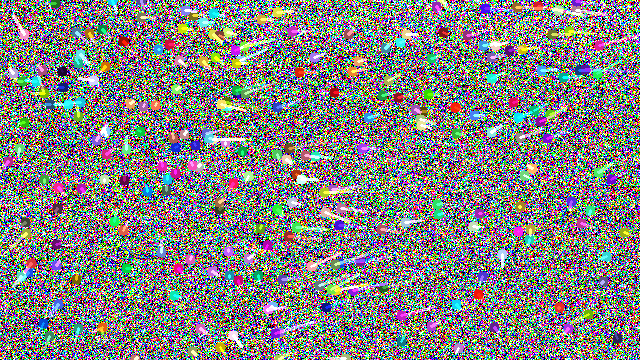

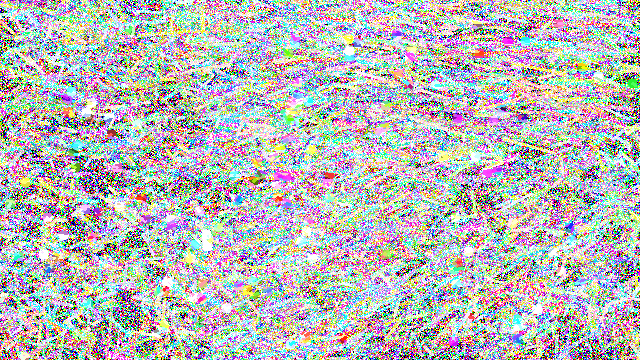

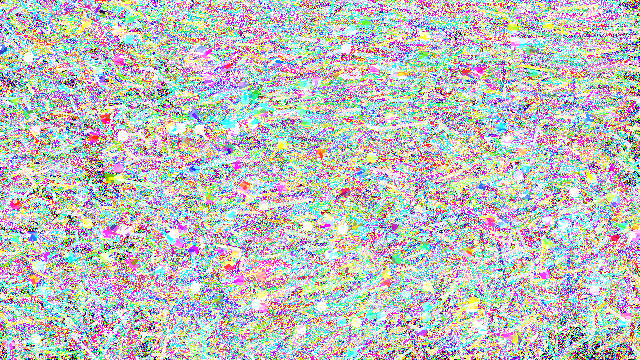

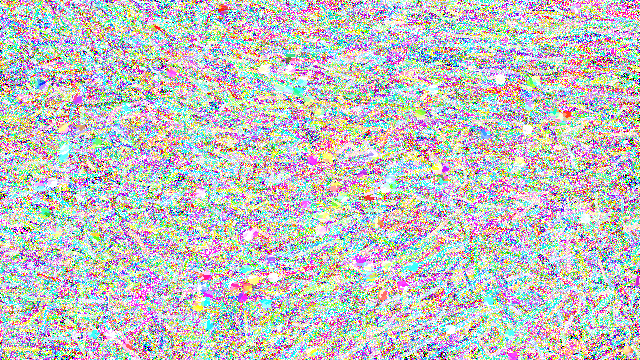

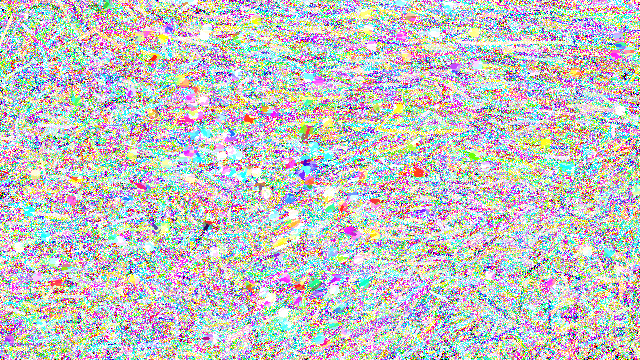

...

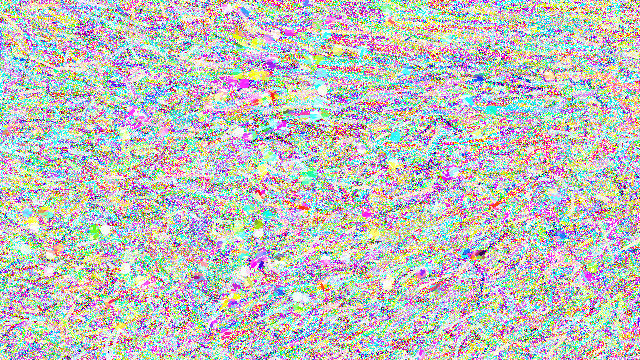

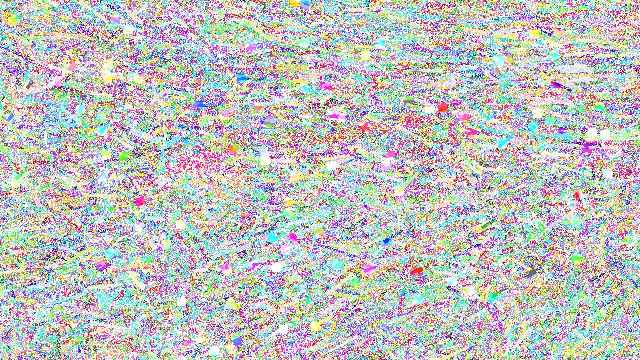

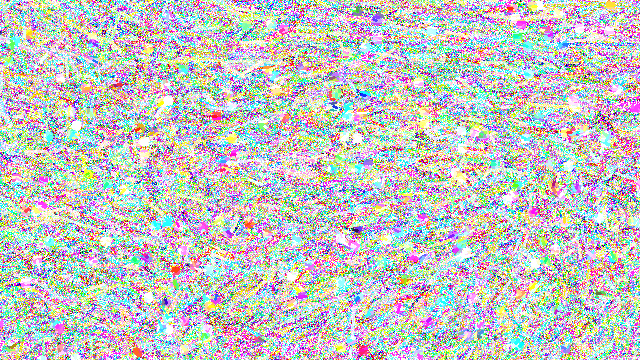

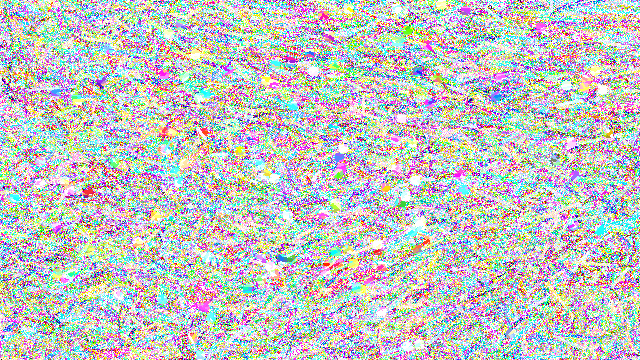

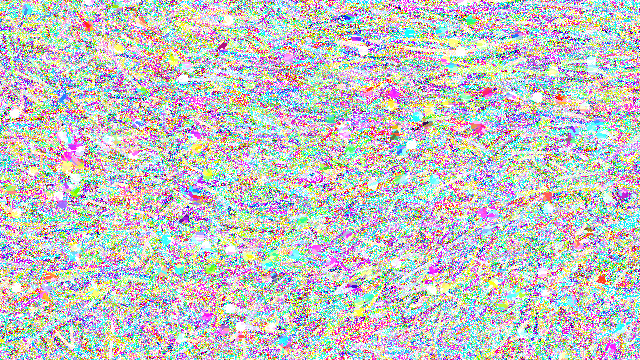

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

Opt_Flow_Noise(feature_params,lk_params,'Shi-Tomasi',frames,30,80,0.9)

Για τον ανιχνευτή Harris:

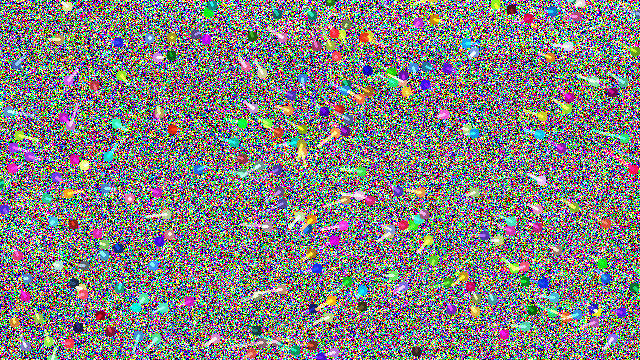

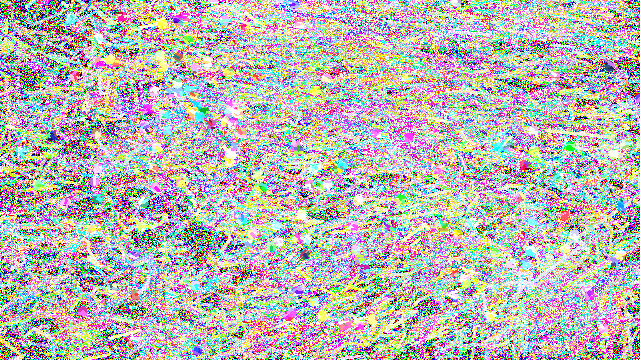

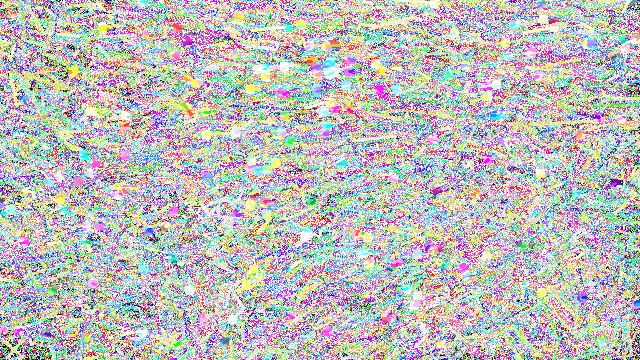

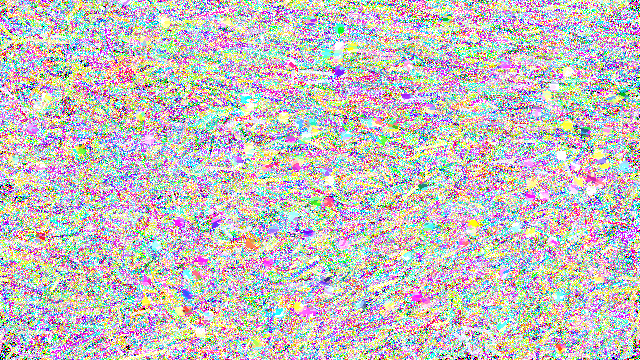

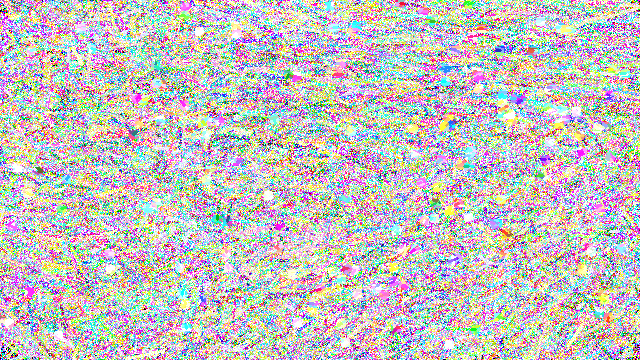

...

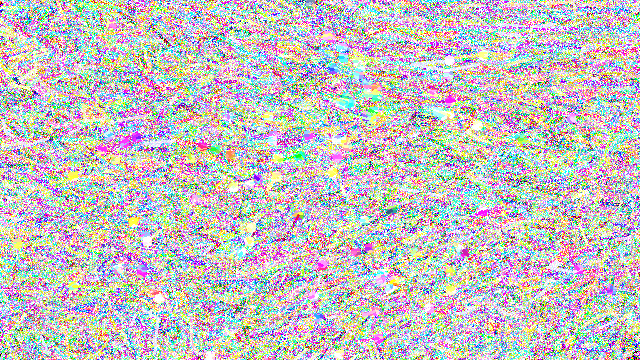

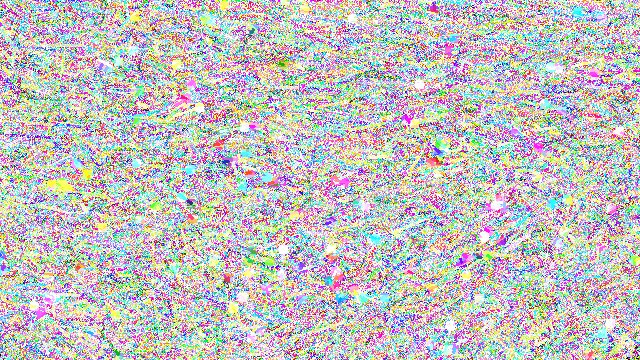

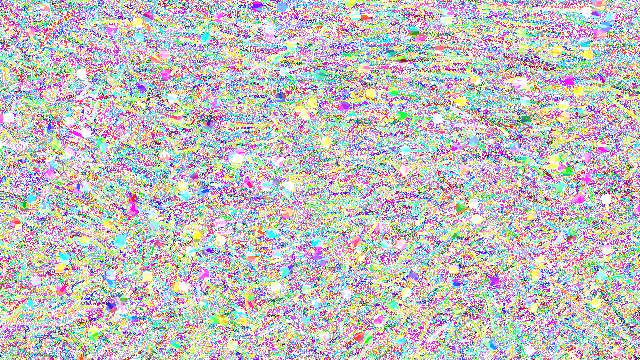

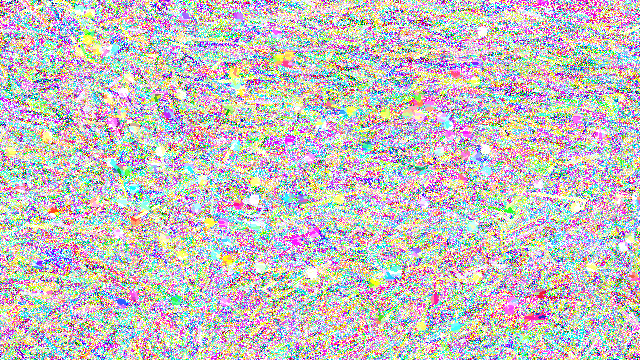

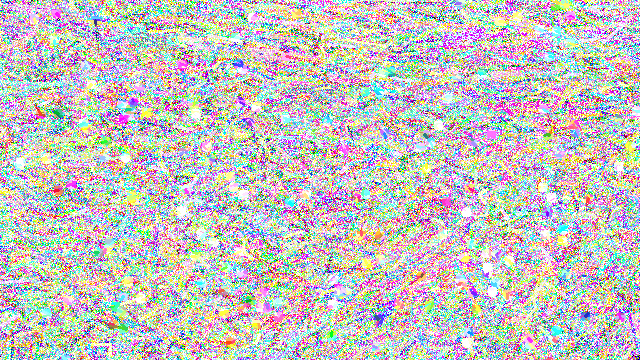

In [ ]:
cap = cv2.VideoCapture(resized_video_50_sec)                                          #read the video again

ret, frame = cap.read()                                                               #read first frame
frames=[frame]                                                                        #save first frame in array    
while(frame is not None):                                                             #read and save the rest of the frames
  ret, frame = cap.read()
  frames.append(frame)

Opt_Flow_Noise(feature_params,lk_params,'Harris',frames,30,80,0.9)

Παρατηρούμε ότι αυξάνοντας την τιμή του SNR η εικόνα γίνεται όλο και πιο θορυβώδης και τελικά σε πολύ μεγάλες τιμές η εικόνα γεμίζει με θόρυβο. Όσον αφορά την επίδραση του θορύβου στο αποτέλεσμα της εκτίμησης κίνησης με optical flow, μπορούμε να παρατηρήσουμε τα εξής:\
Η ύπαρξη θορύβου, ειδικά όταν αυτός έχει μεγάλο SNR, οδηγεί σε ανίχνευση μη υπαρκτών κινήσεων (π.χ. εύρεση κίνησης στον ουρανό στην εικόνα), καθώς σημεία με θόρυβο ανιχνεύονται λανθασμένα ως σημεία ενιδιαφέροντος, τα οποία κινούνται. Αυτό γίνεται περισσότερο εμφανές για τιμή του SNR μεγαλύτερη του 0.2 όπου ανιχνεύονται συνεχώς μη υπαρκτές κινήσεις, με αποτέλεσμα η εικόνα να γεμίζει συνεχώς με σημεία. Βέβαια, ακόμα και για μεγάλες τιμές θορύβου, η κίνηση των πραγματικά κινούμενων ανιτκειμένων (εδώ αυτοκίνητα και πεζοί) εξακολουθεί να ανιχνεύεται επιτυχώς: Καθώς έχουμε πολλαπλές γωνίες σε κάθε αυτοκίνητο, ακόμα και αν κάποια γωνία δεν ανιχνευθεί λόγω θορύβου, λόγω τυχαιότητας του θορύβου συνήθως θα ανιχνευθούν άλλες γωνίες οι οποίες παρακολουθούνται από τον Lucas-Kanade επιτυχώς.\
Έτσι, τελικά για μεγάλες τιμές του θορύβου τα κινούμενα αντικείμενα εξακολουθούν να ανιχνεύονται, αλλά το αποτέλεσμα ανίχνευσης κίνησης είναι εμφανώς αλλοιωμένο, λόγω της προσθήκης λανθασμένης ανίχνευσης μη υπαρκτών κινήσεων.
Επιπλέον, μπορούμε να παρατηρήσουμε ότι η ανίχνευση κίνησης με Optical Flow εμφανίζει μία κάποια ανοχή στον θόρυβο:\
Για SNR=0.05 παρατηρούμε μία πολύ καλή ανίχνευση της οπτικής ροής, παρόμοια με αυτή που έχουμε όταν δεν έχουμε προσθέσει θόρυβο (έχουμε ανίχνευση μη υπαρκτών γωνίων λόγω θορύβου, αλλά δεν ανιχνεύονται έντονες ψευδείς κινήσεις για αυτές).\
Μεταξύ των ανιχνευτών Harris και Shi Tomasi παρατηρούμε ότι επειδή ο Shi Tomasi ανιχνεύει περισσότερες γωνίες από τον Harris, αυτό έχει σαν αποτέλεσμα κατά την προσθήκη του θορύβου να θεωρεί λανθασμένα τον θόρυβο ως γωνία και να τον ανιχνεύει και αυτόν, ενώ σε μια τέτοια περίπτωση ο Harris δεν είναι πάντα σε θέση να την ανιχνεύσει. Παράλληλα, παρατηρούμε ότι το optical flow που ανιχνεύεται από τον Harris παρουσιάζει διακοπτόμενες γραμμές κάτι το οποίο δεν ισχύει στην περίπτωση του Shi Tomasi.\
**Συμπερασματικά, θεωρούμε ότι ο ανιχνευτής Harris παράγει ελαφρώς καλύτερα συνολικά αποτελέσματα καθώς πετυχαίνουμε μία ευδιάκριτη οπτική ροή (ωστόσο όχι τόσο ευδιάκριτη όσο με τον Shi Tomasi) χωρίς την εμφάνιση πολλών μη υπαρκτών κινήσεων.**

